<a href="https://colab.research.google.com/github/Rm-Bng/EEE569-Assignments/blob/Assignment2/CV_part2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Instance Segmentation and Gender Classification Task**

In [ ]:
# download detectron2
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 7.3 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15837, done.
remote: Counting objects: 100% (65/65), done.
remote: Compressing objects: 100% (51/51), done.
remote: Total 15837 (delta 35), reused 14 (delta 14), pack-reused 15772 (from 2)
Receiving objects: 100% (15837/15837), 6.41 MiB | 9.87 MiB/s, done.
Resolving deltas: 100% (11533/11533), done.
Ignoring dataclasses: markers 'python_version < "3.7"' don't match your en

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2024 NVIDIA Corporation
Built on Thu_Jun__6_02:18:23_PDT_2024
Cuda compilation tools, release 12.5, V12.5.82
Build cuda_12.5.r12.5/compiler.34385749_0
torch:  2.5 ; cuda:  cu124
detectron2: 0.6


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

In [ ]:
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

from detectron2.structures import BoxMode
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.engine import DefaultTrainer
from detectron2.utils.visualizer import ColorMode

Download **Multi-Human Parsing** v-2 dataset

In [ ]:
# Dataset downloading
!gdown 1YVBGMru0dlwB8zu1OoErOazZoc8ISSJn

In [ ]:
# Dataset extraction
!jar xf /content/LV-MHP-v2.zip

In [ ]:
# For the assignment the first 300 image from training set are used
import shutil

source_folder = '/content/LV-MHP-v2/train/images'
destination_folder = '/content/Segmentation/train/images'

os.makedirs(destination_folder, exist_ok=True)

for i in range(1, 475):
    image_filename = f"{i}.jpg"
    source_image_path = os.path.join(source_folder, image_filename)
    destination_image_path = os.path.join(destination_folder, image_filename)
    if os.path.exists(source_image_path):
        shutil.copy(source_image_path, destination_image_path)


In [ ]:
# copy first 100 image from validation set in another file
src_folder = '/content/LV-MHP-v2/val/images'
dst_folder = '/content/Segmentation/val/images'
os.makedirs(dst_folder, exist_ok=True)

image_files = [f for f in os.listdir(src_folder) if f.endswith(".jpg")]

image_files.sort(key=lambda x: int(os.path.splitext(x)[0]))

# Select the first 100 smallest images by filename
smallest_images = image_files[:100]

for img in smallest_images:
    shutil.copy(os.path.join(src_folder, img), os.path.join(dst_folder, img))

print(f"Copied {len(smallest_images)} images to {dst_folder}")

In [ ]:
# after copy the desired images delete dataset files
folder_path = "/content/LV-MHP-v2"
shutil.rmtree(folder_path)

file_path = "/content/LV-MHP-v2.zip"
if os.path.exists(file_path):
    os.remove(file_path)

In [ ]:
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

In [ ]:
#Import annotations
import shutil
source_path = '/content/drive/MyDrive/Colab Notebooks/annotations.json'
destination_path = '/content/Segmentation/train'
shutil.copy(source_path, destination_path)

source_path = '/content/drive/MyDrive/Colab Notebooks/val_annotations.json'
destination_path = '/content/Segmentation/val'
shutil.copy(source_path, destination_path)


'/content/Segmentation/val/val_annotations.json'

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances(
    "my_dataset_train",
    {},
    "/content/Segmentation/train/annotations.json",  # Path to COCO annotations file
    "/content/Segmentation/train/images"  # Path to image directory
)
register_coco_instances(
    "my_dataset_val",
    {},
    "/content/Segmentation/val/val_annotations.json",  # Path to COCO annotations file
    "/content/Segmentation/val/images"  # Path to image directory
)


## Training

### First model

In [ ]:
cfg0 = get_cfg()
cfg0.merge_from_file("detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Choose a model
cfg0.DATASETS.TRAIN = ("my_dataset_train",)
cfg0.DATASETS.TEST = ("my_dataset_val",)
cfg0.DATALOADER.NUM_WORKERS = 2
cfg0.SOLVER.IMS_PER_BATCH = 2
cfg0.SOLVER.BASE_LR = 0.00025
cfg0.SOLVER.MAX_ITER = 6000
cfg0.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg0.MODEL.ROI_HEADS.NUM_CLASSES = 4

cfg0.OUTPUT_DIR = "./output0"
os.makedirs(cfg0.OUTPUT_DIR, exist_ok=True)

cfg0.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"

trainer0 = DefaultTrainer(cfg0)
trainer0.resume_or_load(resume=False)
trainer0.train()

[02/15 16:33:16 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:01, 172MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[02/15 16:33:17 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.11/dist-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[02/15 16:33:31 d2.utils.events]:  eta: 0:43:30  iter: 19  total_loss: 3.257  loss_cls: 1.509  loss_box_reg: 0.8829  loss_mask: 0.6924  loss_rpn_cls: 0.1459  loss_rpn_loc: 0.03571    time: 0.4376  last_time: 0.5056  data_time: 0.0309  last_data_time: 0.0213   lr: 4.9953e-06  max_mem: 2456M
[02/15 16:33:50 d2.utils.events]:  eta: 0:43:35  iter: 39  total_loss: 3.212  loss_cls: 1.452  loss_box_reg: 0.8771  loss_mask: 0.6908  loss_rpn_cls: 0.1443  loss_rpn_loc: 0.03556    time: 0.4408  last_time: 0.4629  data_time: 0.0083  last_data_time: 0.0055   lr: 9.9902e-06  max_mem: 2456M
[02/15 16:33:58 d2.utils.events]:  eta: 0:43:43  iter: 59  total_loss: 3.032  loss_cls: 1.319  loss_box_reg: 0.8156  loss_mask: 0.687  loss_rpn_cls: 0.1232  loss_rpn_loc: 0.02496    time: 0.4415  last_time: 0.4898  data_time: 0.0098  last_data_time: 0.0154   lr: 1.4985e-05  max_mem: 2457M
[02/15 16:34:07 d2.utils.events]:  eta: 0:43:28  iter: 79  total_loss: 2.872  loss_cls: 1.167  loss_box_reg: 0.8767  loss_mask: 

In [ ]:
source_folder = "/content/output0"  # Folder to be copied
destination_folder = "/content/drive/MyDrive/Colab Notebooks/Detectron2_Outputs"  # Destination in Google Drive
os.makedirs(destination_folder, exist_ok=True)
shutil.copytree(source_folder, destination_folder, dirs_exist_ok=True)

'/content/drive/MyDrive/Colab Notebooks/Detectron2_Outputs'

In [ ]:
source_path = '/content/drive/MyDrive/Colab Notebooks/Detectron2_Outputs/model0/model_final.pth'
destination_path = '/content/Segmentation/train'
shutil.copy(source_path, destination_path)


'/content/Segmentation/train/model_final.pth'

In [ ]:
cfg0 = get_cfg()
cfg0.MODEL.DEVICE = "cpu"
cfg0.merge_from_file("detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg0.DATASETS.TRAIN = ("my_dataset_train",)
cfg0.DATASETS.TEST = ("my_dataset_val",)  # Use the validation dataset now
cfg0.DATALOADER.NUM_WORKERS = 2
cfg0.MODEL.ROI_HEADS.NUM_CLASSES = 4
cfg0.MODEL.WEIGHTS = "/content/Segmentation/train/model_final.pth"  # Load trained model
cfg0.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set a confidence threshold

# Build the predictor
predictor = DefaultPredictor(cfg0)

[02/16 16:59:56 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/Segmentation/train/model_final.pth ...


/usr/local/lib/python3.11/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

In [ ]:
evaluator = COCOEvaluator("my_dataset_val", cfg0, False, output_dir="./output0/")
val_loader = build_detection_test_loader(cfg0, "my_dataset_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))


[02/16 14:41:00 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [02/16 14:41:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[02/16 14:41:00 d2.data.datasets.coco]: Loaded 100 images in COCO format from /content/Segmentation/val/val_annotations.json
[02/16 14:41:00 d2.data.build]: Distribution of instances among all 4 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|    man     | 196          |   woman    | 95           | woman_face | 89           |
| woman_hand | 109          |            |              |            |              |
|   total    | 489          |            |              |            |              |
[02/16 14:41:00 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in i

/usr/local/lib/python3.11/dist-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[02/16 14:41:11 d2.evaluation.evaluator]: Inference done 1/100. Dataloading: 0.3305 s/iter. Inference: 11.2838 s/iter. Eval: 0.0073 s/iter. Total: 11.6233 s/iter. ETA=0:19:10
[02/16 14:41:21 d2.evaluation.evaluator]: Inference done 2/100. Dataloading: 0.1678 s/iter. Inference: 10.4084 s/iter. Eval: 0.0068 s/iter. Total: 10.5847 s/iter. ETA=0:17:17
[02/16 14:41:30 d2.evaluation.evaluator]: Inference done 3/100. Dataloading: 0.1160 s/iter. Inference: 10.0285 s/iter. Eval: 0.0064 s/iter. Total: 10.1539 s/iter. ETA=0:16:24
[02/16 14:41:40 d2.evaluation.evaluator]: Inference done 4/100. Dataloading: 0.0873 s/iter. Inference: 10.0195 s/iter. Eval: 0.0057 s/iter. Total: 10.1152 s/iter. ETA=0:16:11
[02/16 14:41:50 d2.evaluation.evaluator]: Inference done 5/100. Dataloading: 0.0705 s/iter. Inference: 9.8997 s/iter. Eval: 0.0059 s/iter. Total: 9.9785 s/iter. ETA=0:15:47
[02/16 14:41:58 d2.evaluation.evaluator]: Inference done 6/100. Dataloading: 0.0000 s/iter. Inference: 8.7984 s/iter. Eval: 0.0

Showing results for: 251.jpg


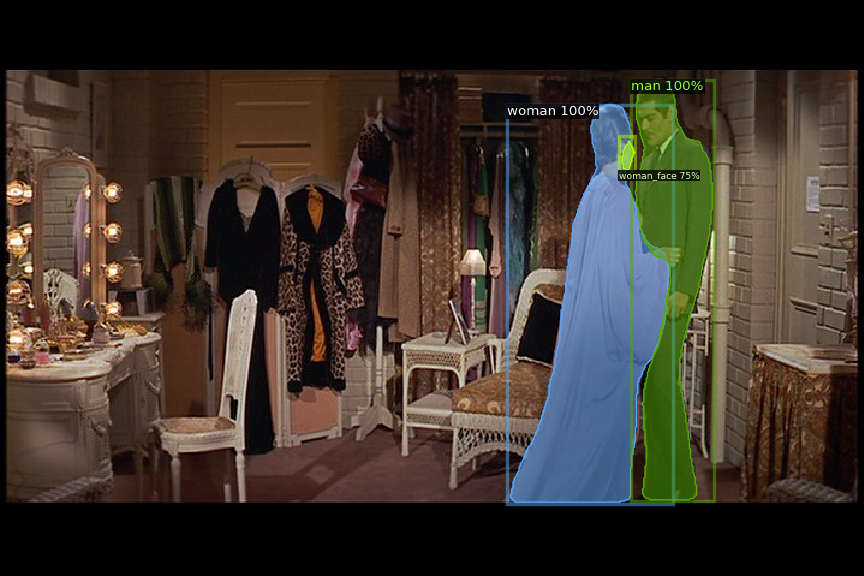

Showing results for: 93.jpg


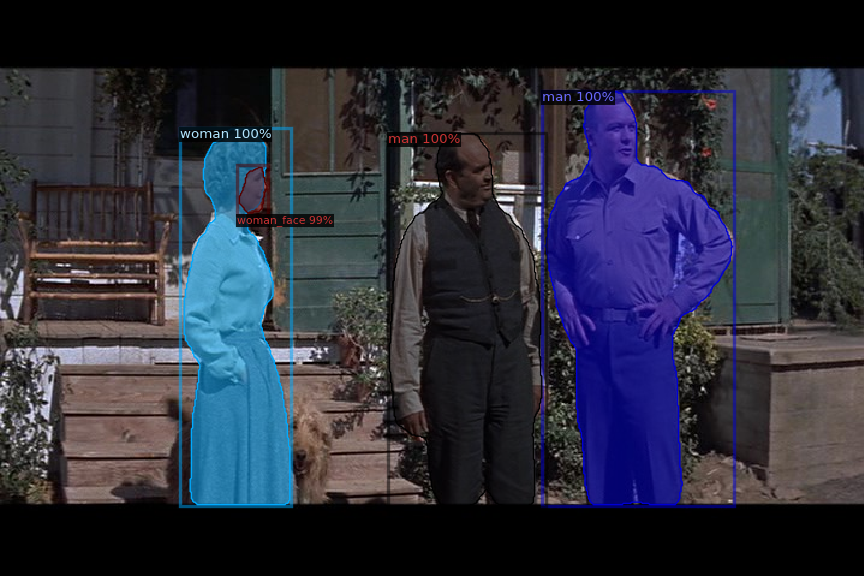

Showing results for: 300.jpg


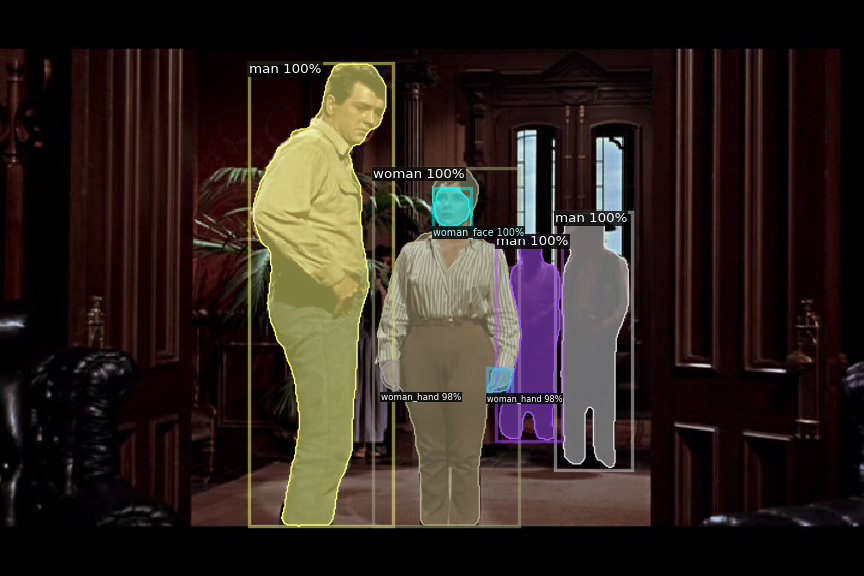

Showing results for: 263.jpg


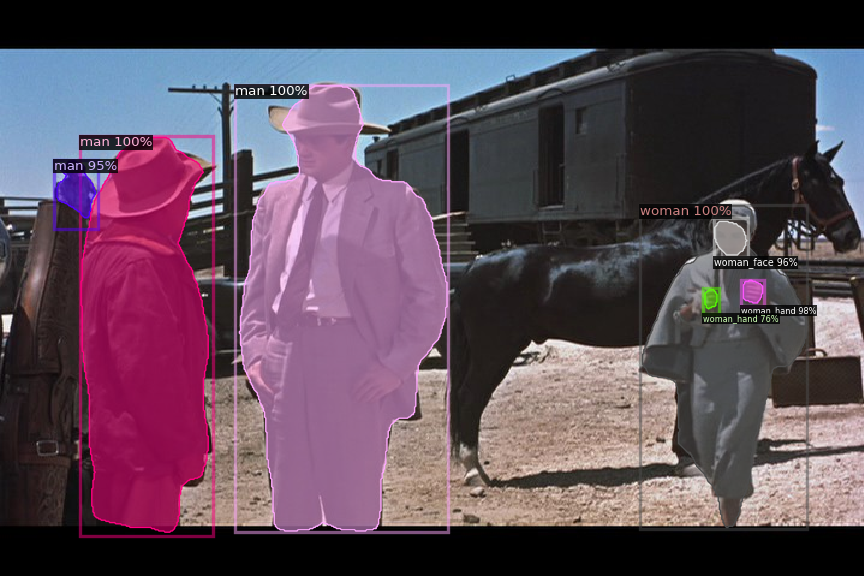

Showing results for: 16.jpg


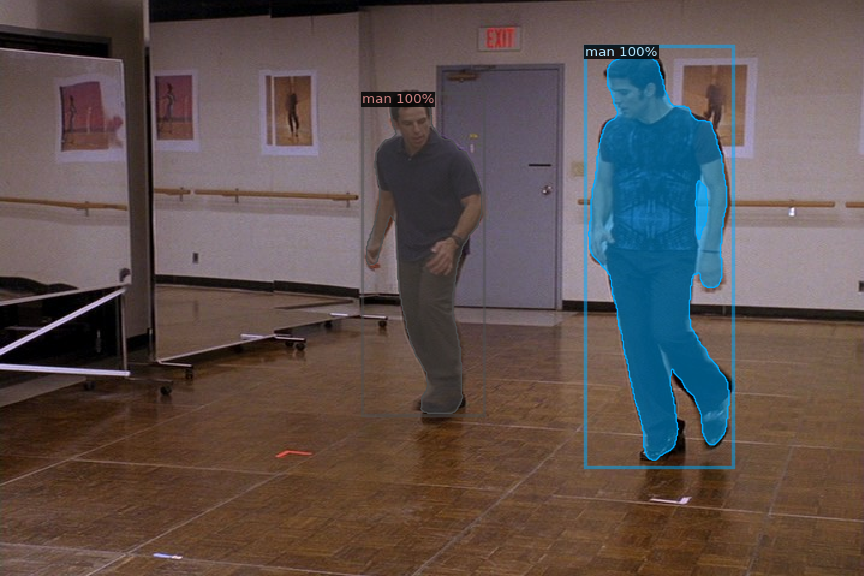

In [ ]:
import glob

val_images_folder = "/content/Segmentation/val/images/"
image_paths = glob.glob(os.path.join(val_images_folder, "*.jpg"))  # Change to "*.png" if needed

random_images = random.sample(image_paths, 5)
confidence_threshold = 0.5

for image_path in random_images:
    image = cv2.imread(image_path)
    outputs = predictor(image)

    instances = outputs["instances"]
    scores = instances.scores
    keep = scores >= confidence_threshold
    instances = instances[keep]

    visualizer = Visualizer(image[:, :, ::-1], MetadataCatalog.get("my_dataset_val"), scale=1.2)
    vis = visualizer.draw_instance_predictions(instances.to("cpu"))
    cv2_imshow(vis.get_image()[:, :, ::-1])


cv2.destroyAllWindows()


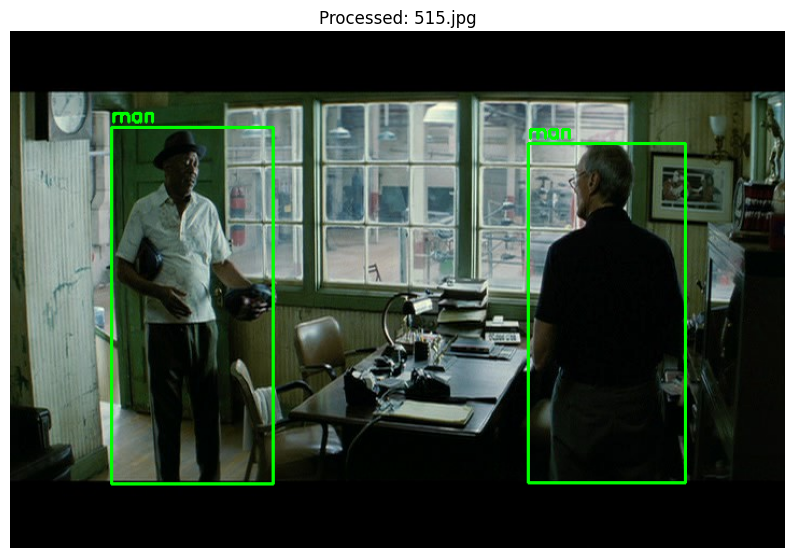

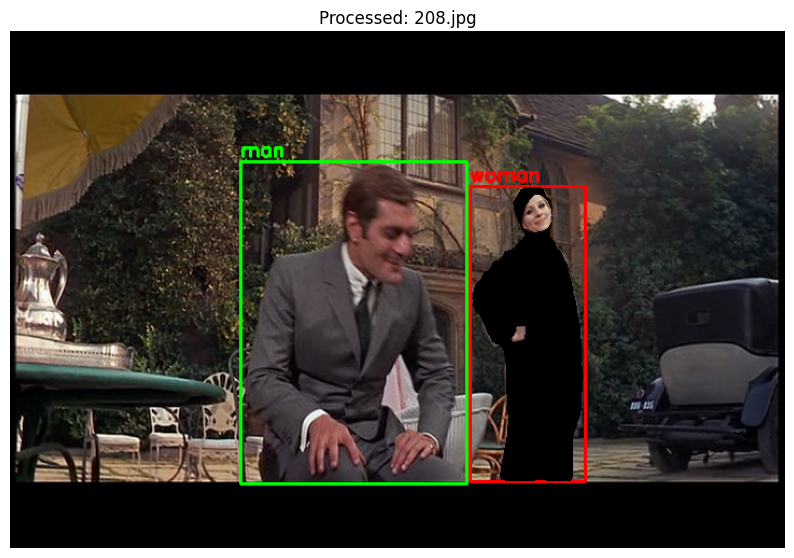

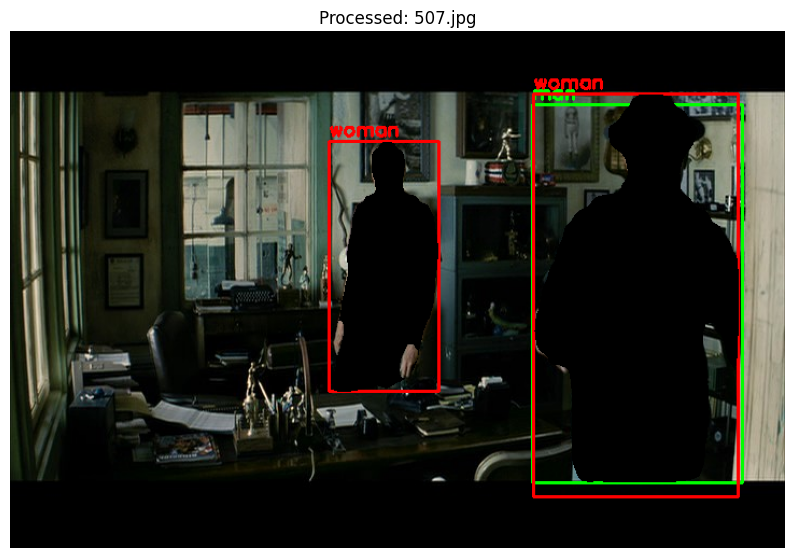

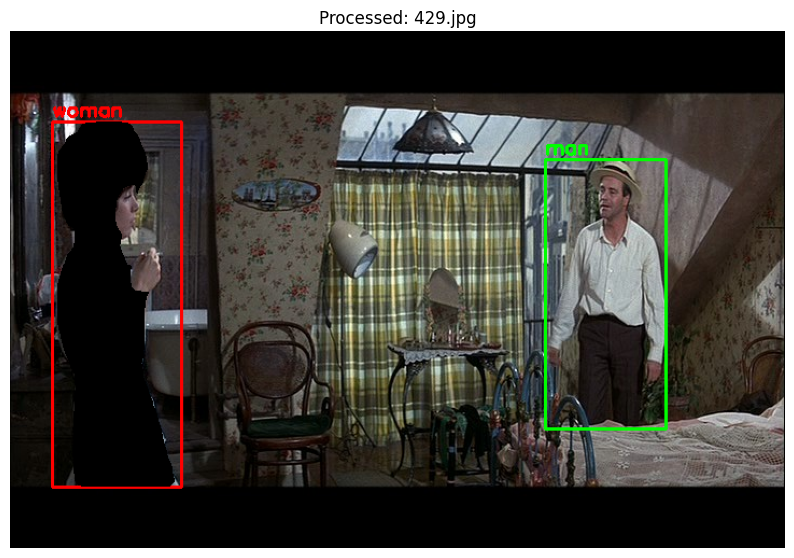

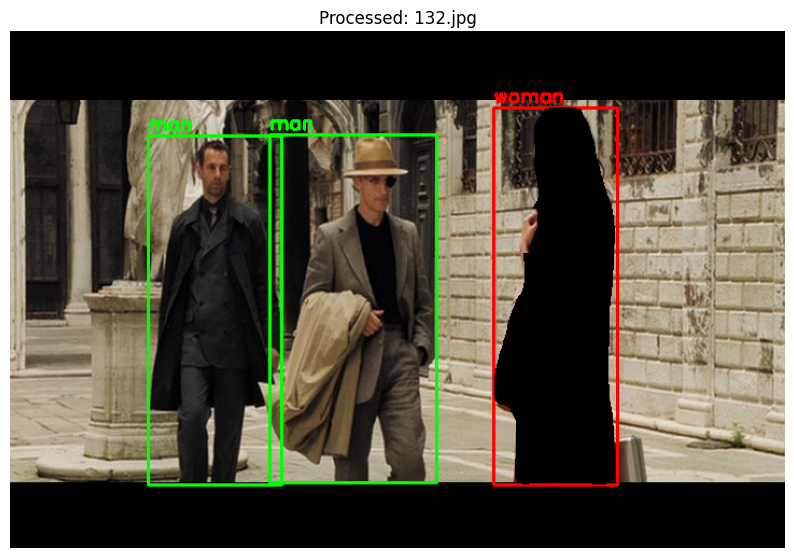

...

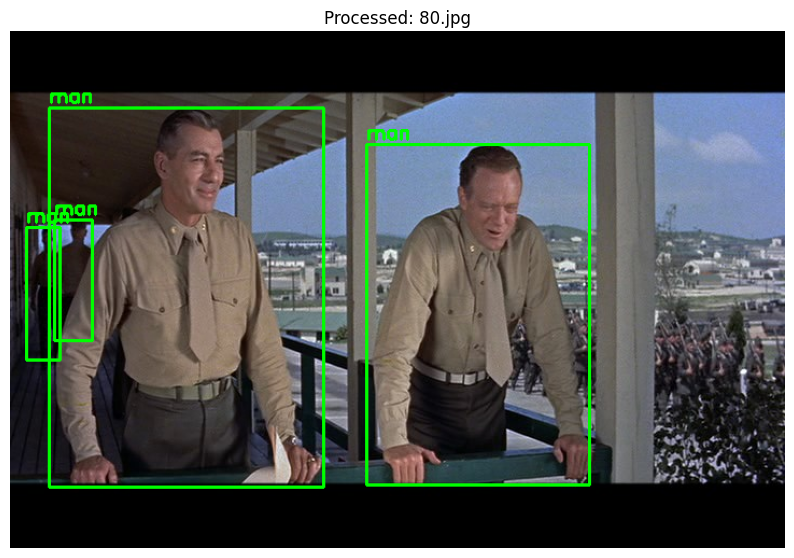

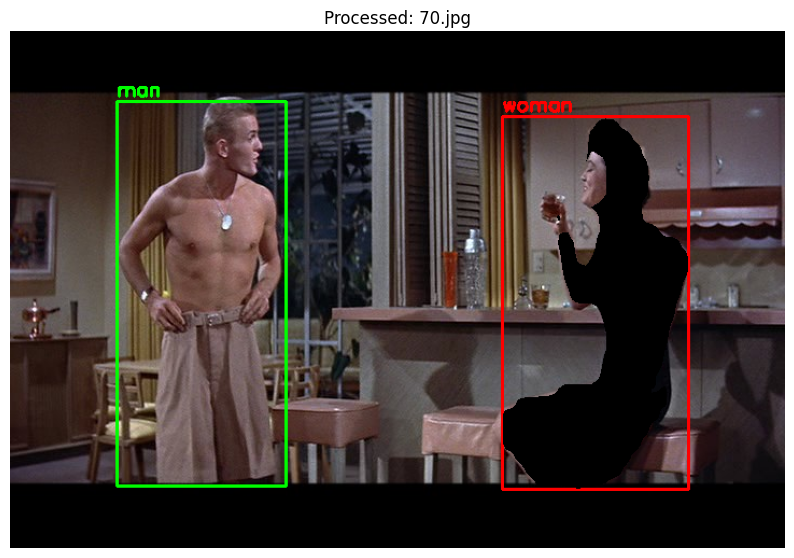

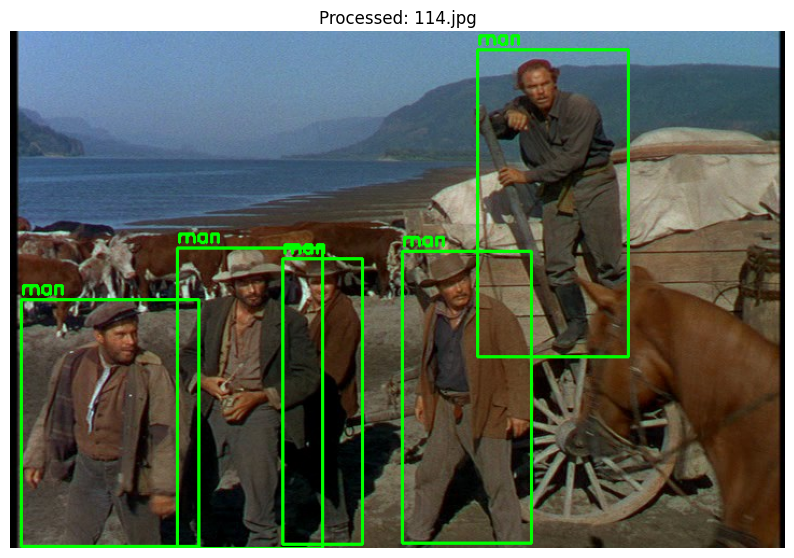

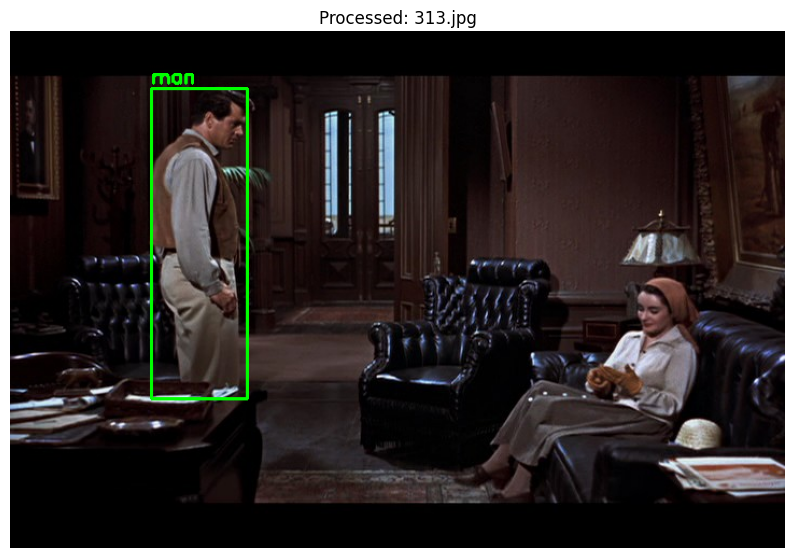

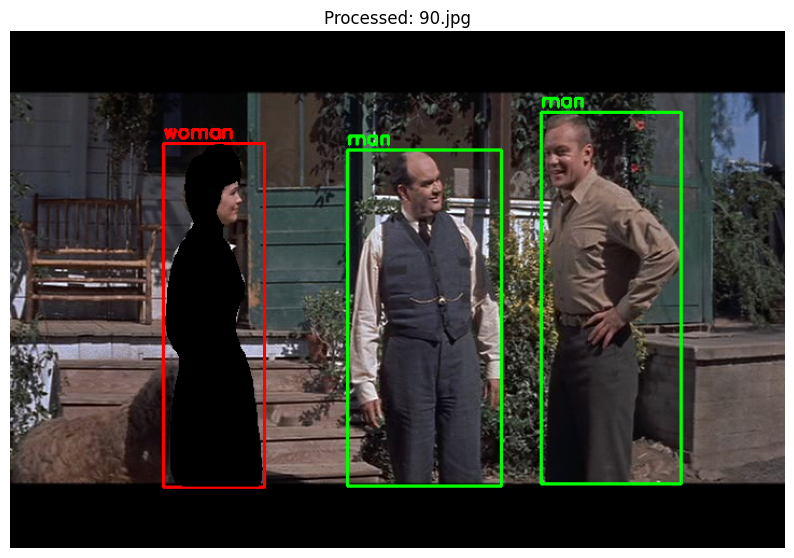

Processed 20 random images.


In [ ]:
import matplotlib.pyplot as plt

val_images_folder = "/content/Segmentation/val/images/"

image_paths = glob.glob(os.path.join(val_images_folder, "*.jpg"))
random_images = random.sample(image_paths, min(20, len(image_paths)))

class_labels = {1: "man", 2: "woman"}
colors = {1: (0, 255, 0), 2: (255, 0, 0)}

CONFIDENCE_THRESHOLD = 0.7
MASK_THRESHOLD = 0.7

for image_path in random_images:
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    height, width = image_rgb.shape[:2]

    outputs = predictor(image)

    # Extract predictions
    instances = outputs["instances"].to("cpu")
    scores = instances.scores.numpy()

    valid_indices = scores > CONFIDENCE_THRESHOLD
    pred_boxes = instances.pred_boxes.tensor.numpy()[valid_indices]
    pred_classes = (instances.pred_classes.numpy() + 1)[valid_indices]
    pred_masks = instances.pred_masks.numpy()[valid_indices]

    pred_masks = (pred_masks > MASK_THRESHOLD).astype(np.uint8)

    mask_category_2 = np.zeros((height, width), dtype=np.uint8)  # Mask for woman
    mask_category_3_4 = np.zeros((height, width), dtype=np.uint8)  # Mask for face & hand

    # Process predictions
    for i in range(len(pred_classes)):
        category_id = pred_classes[i]
        mask = pred_masks[i]

        if category_id == 2:
            mask_category_2 = np.maximum(mask_category_2, mask)

        elif category_id in [3, 4]:  # Face & hand
            mask_category_3_4 = np.maximum(mask_category_3_4, mask)

        # Draw bounding boxes for man and woman classes
        if category_id in [1, 2]:
            x, y, x2, y2 = map(int, pred_boxes[i])
            color = colors[category_id]
            cv2.rectangle(image_rgb, (x, y), (x2, y2), color, 2)
            cv2.putText(image_rgb, class_labels[category_id],
                        (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

    # Remove overlapping areas from woman mask
    mask_category_2[mask_category_3_4 > 0] = 0

    # Apply the black mask to woman 2
    image_rgb[mask_category_2 > 0] = [0, 0, 0]


    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis("off")
    plt.title(f"Processed: {os.path.basename(image_path)}")
    plt.show()

print(f"Processed {len(random_images)} random images.")


### Second model

In [ ]:
cfg1 = get_cfg()
cfg1.merge_from_file("detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
cfg1.DATASETS.TRAIN = ("my_dataset_train",)
cfg1.DATASETS.TEST = ("my_dataset_val",)
cfg1.DATALOADER.NUM_WORKERS = 2
cfg1.SOLVER.IMS_PER_BATCH = 2
cfg1.SOLVER.BASE_LR = 0.00025
cfg1.SOLVER.MAX_ITER = 6000
cfg1.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg1.MODEL.ROI_HEADS.NUM_CLASSES = 4

cfg1.OUTPUT_DIR = "./output1"
os.makedirs(cfg1.OUTPUT_DIR, exist_ok=True)

cfg1.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x/138205316/model_final_a3ec72.pkl"

# Train
trainer1 = DefaultTrainer(cfg1)
trainer1.resume_or_load(resume=False)
trainer1.train()

[02/15 17:58:49 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a3ec72.pkl: 254MB [00:02, 97.1MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[02/15 17:58:52 d2.engine.train_loop]: Starting training from iteration 0
[02/15 17:59:05 d2.utils.events]:  eta: 1:04:33  iter: 19  total_loss: 3.412  loss_cls: 1.627  loss_box_reg: 0.8712  loss_mask: 0.6954  loss_rpn_cls: 0.1923  loss_rpn_loc: 0.03495    time: 0.6307  last_time: 0.5826  data_time: 0.0199  last_data_time: 0.0053   lr: 4.9953e-06  max_mem: 4378M
[02/15 17:59:19 d2.utils.events]:  eta: 1:05:20  iter: 39  total_loss: 3.37  loss_cls: 1.579  loss_box_reg: 0.8736  loss_mask: 0.6929  loss_rpn_cls: 0.1747  loss_rpn_loc: 0.0341    time: 0.6548  last_time: 0.7396  data_time: 0.0104  last_data_time: 0.0055   lr: 9.9902e-06  max_mem: 4378M
[02/15 17:59:33 d2.utils.events]:  eta: 1:06:00  iter: 59  total_loss: 3.124  loss_cls: 1.437  loss_box_reg: 0.8586  loss_mask: 0.6885  loss_rpn_cls: 0.1129  loss_rpn_loc: 0.02835    time: 0.6637  last_time: 0.7466  data_time: 0.0096  last_data_time: 0.0062   lr: 1.4985e-05  max_mem: 4378M
[02/15 17:59:46 d2.utils.events]:  eta: 1:06:16  iter: 

In [ ]:
source_folder = "/content/output1"  # Folder to be copied
destination_folder = "/content/drive/MyDrive/Colab Notebooks/Detectron2_Outputs"  # Destination in Google Drive
os.makedirs(destination_folder, exist_ok=True)
shutil.copytree(source_folder, destination_folder, dirs_exist_ok=True)

'/content/drive/MyDrive/Colab Notebooks/Detectron2_Outputs'

In [ ]:
source_path = '/content/drive/MyDrive/Colab Notebooks/Detectron2_Outputs/model1/model_final.pth'
destination_path = '/content/Segmentation/train/model1'
shutil.copy(source_path, destination_path)

'/content/Segmentation/train/model1'

In [ ]:
cfg1 = get_cfg()
cfg1.MODEL.DEVICE = "cpu"
cfg1.merge_from_file("detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
cfg1.DATASETS.TRAIN = ("my_dataset_train",)
cfg1.DATASETS.TEST = ("my_dataset_val",)
cfg1.MODEL.ROI_HEADS.NUM_CLASSES = 4
cfg1.MODEL.WEIGHTS = "/content/Segmentation/train/model1/model_final.pth"  # Load trained model
cfg1.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

predictor1 = DefaultPredictor(cfg1)

In [ ]:
# evaluation
evaluator1 = COCOEvaluator("my_dataset_val", cfg1, False, output_dir="./output1/")
val_loader1 = build_detection_test_loader(cfg1, "my_dataset_val")
print(inference_on_dataset(predictor1.model, val_loader1, evaluator1))

[02/16 15:21:36 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [02/16 15:21:36 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[02/16 15:21:36 d2.data.datasets.coco]: Loaded 100 images in COCO format from /content/Segmentation/val/val_annotations.json
[02/16 15:21:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[02/16 15:21:36 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[02/16 15:21:36 d2.data.common]: Serializing 100 elements to byte tensors and concatenating them all ...
[02/16 15:21:36 d2.data.common]: Serialized dataset takes 0.24 MiB
[02/16 15:21:36 d2.evaluation.evaluator]: Start inference on 100 batches
[02/16 15:21:49 d2.evaluation.evaluator]: Inferenc

Showing results for: 7.jpg


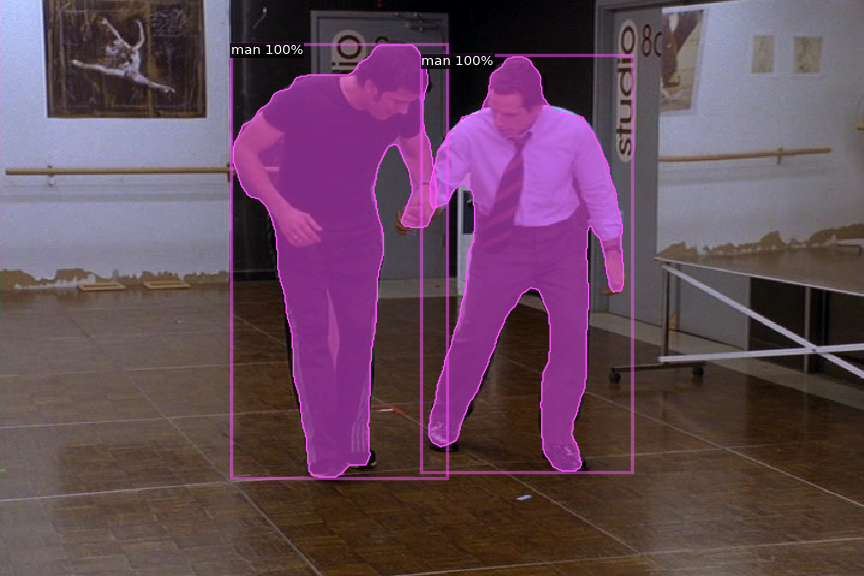

Showing results for: 220.jpg


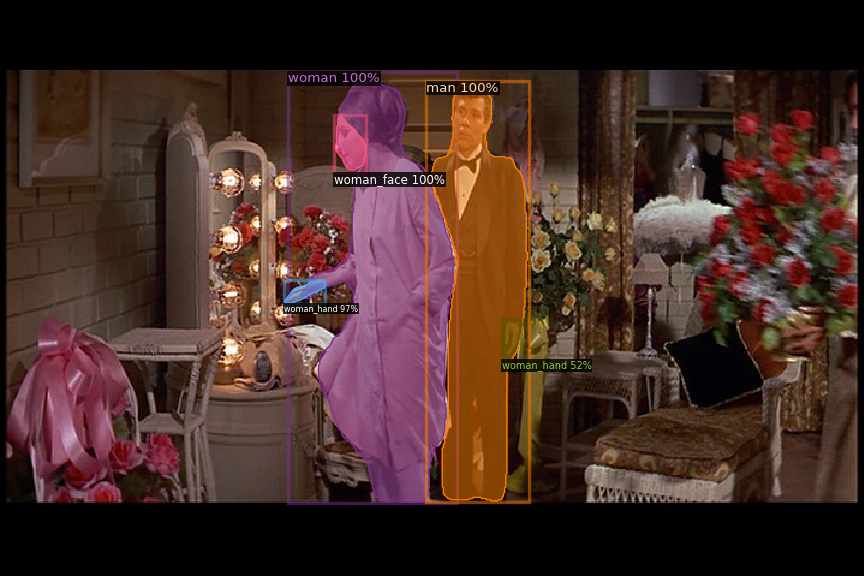

Showing results for: 464.jpg


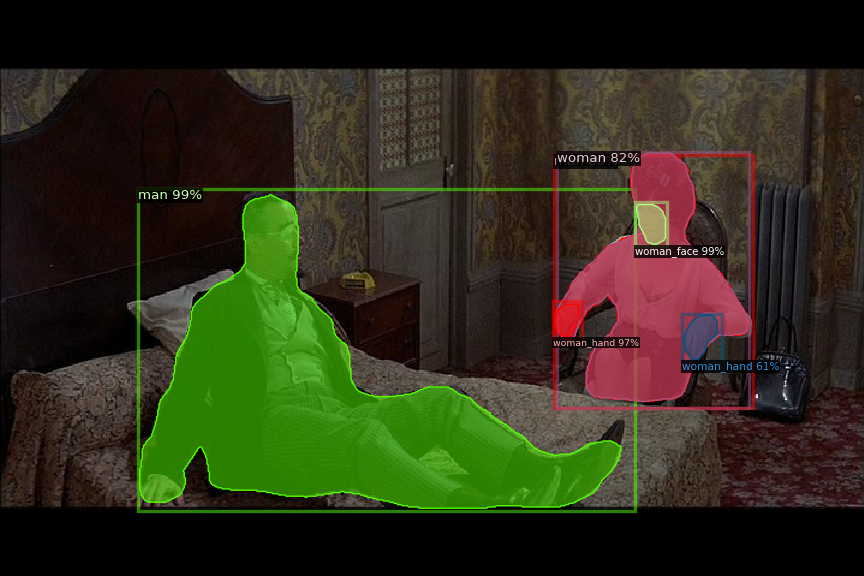

Showing results for: 80.jpg


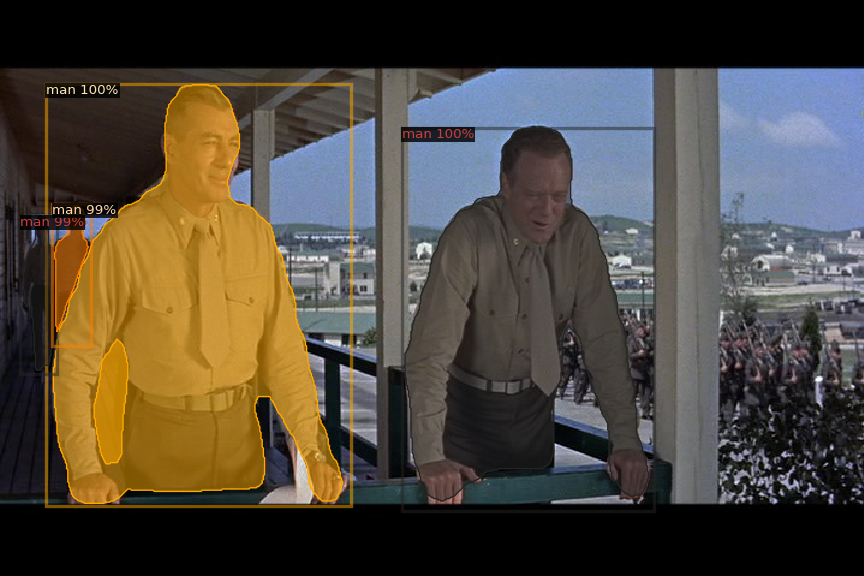

Showing results for: 81.jpg


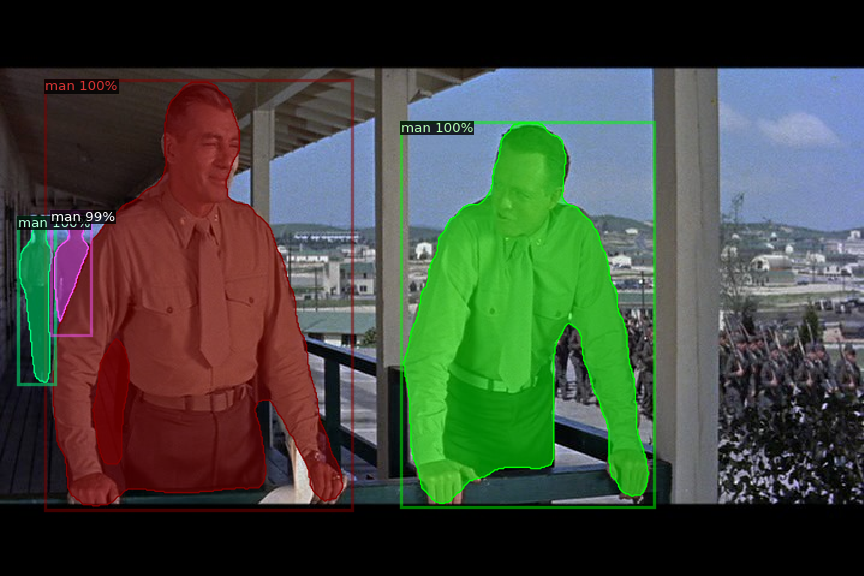

In [ ]:
# Randomly select 5 images
random_images = random.sample(image_paths, 5)

confidence_threshold = 0.5
for image_path in random_images:
    image = cv2.imread(image_path)

    outputs = predictor1(image)
    instances = outputs["instances"]
    scores = instances.scores
    keep = scores >= confidence_threshold
    instances = instances[keep]

    visualizer = Visualizer(image[:, :, ::-1], MetadataCatalog.get("my_dataset_val"), scale=1.2)
    vis = visualizer.draw_instance_predictions(instances.to("cpu"))

    cv2_imshow(vis.get_image()[:, :, ::-1])


cv2.destroyAllWindows()


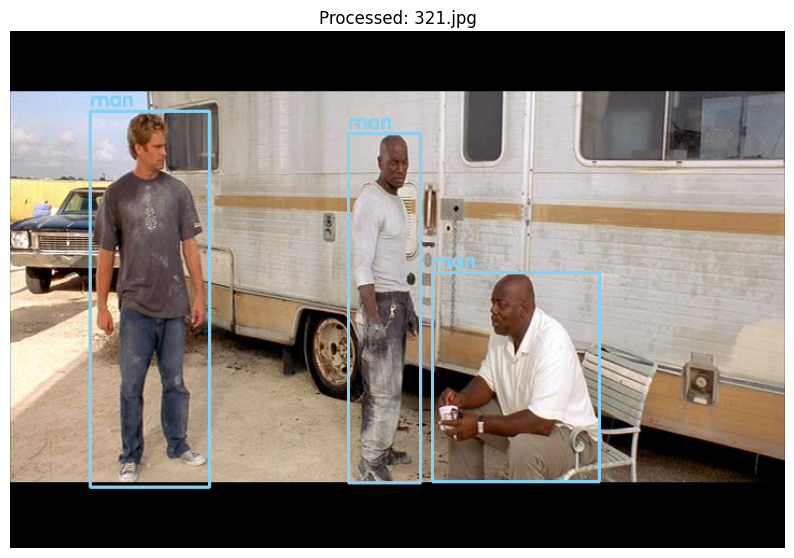

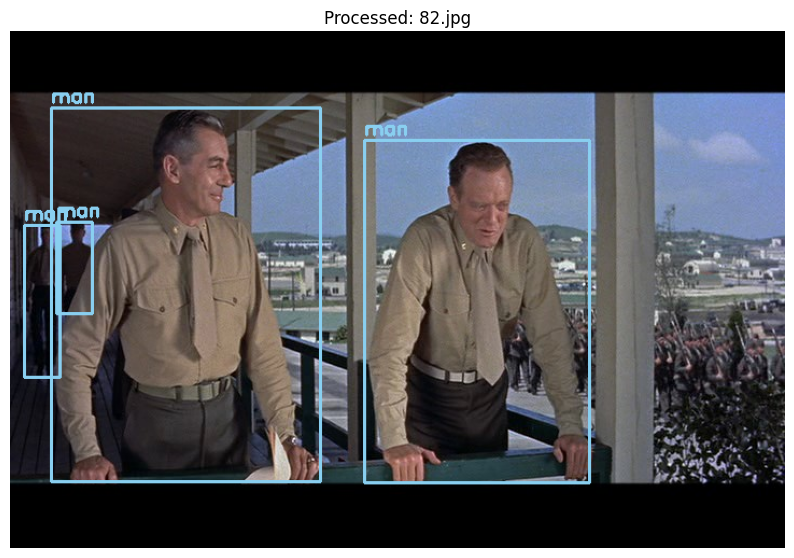

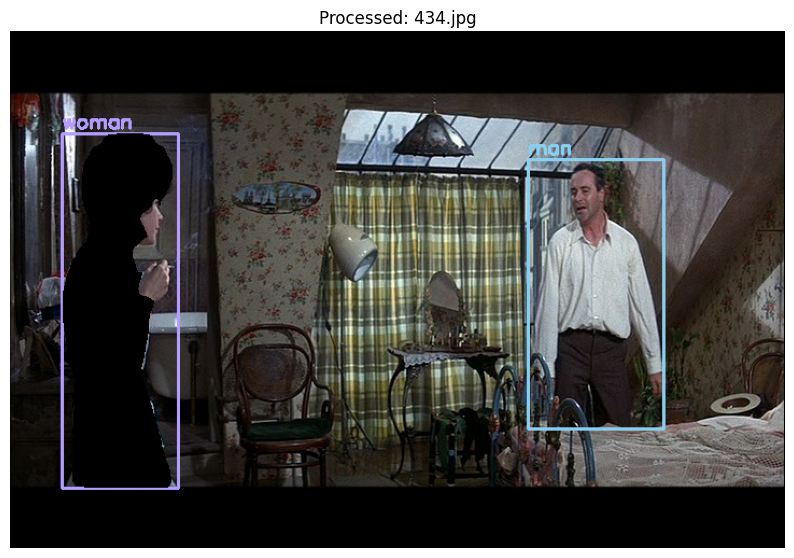

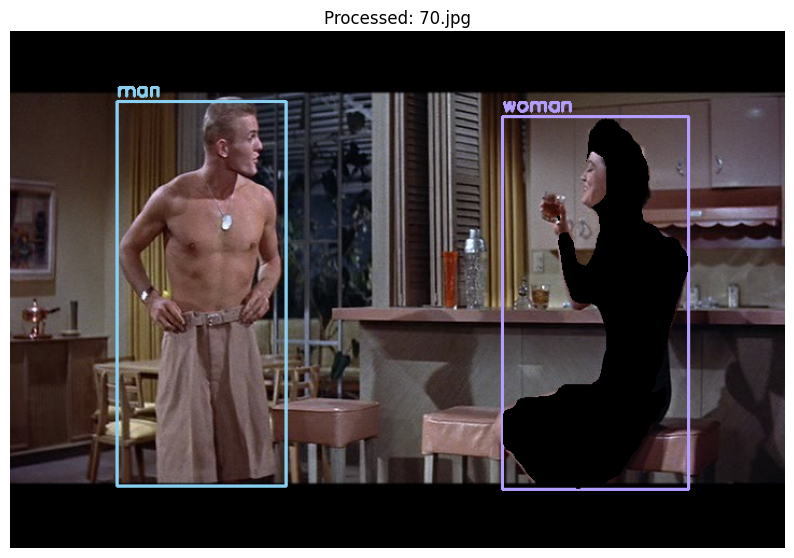

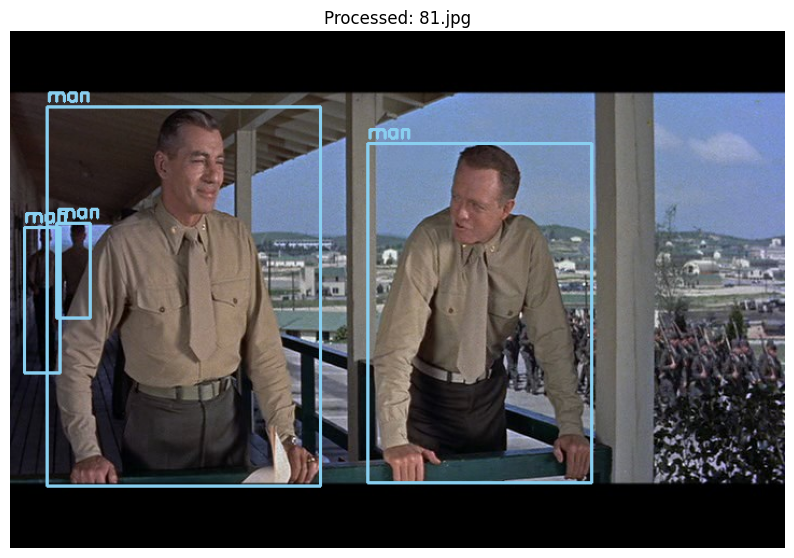

...

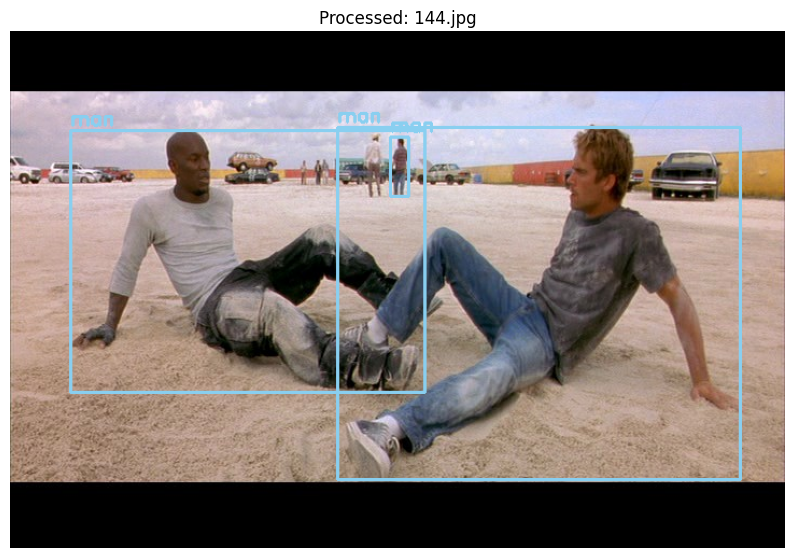

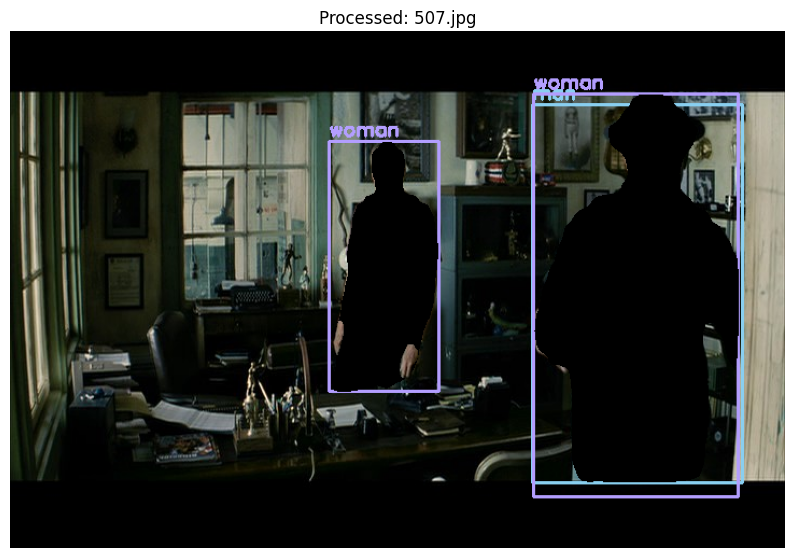

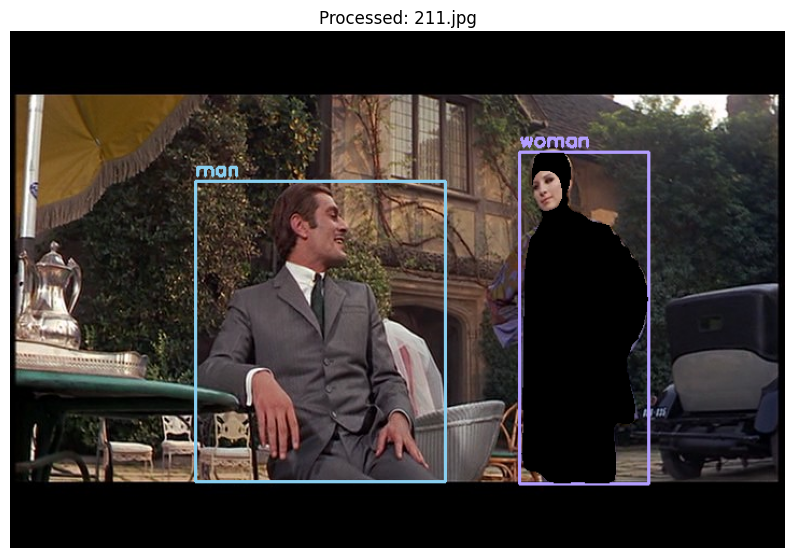

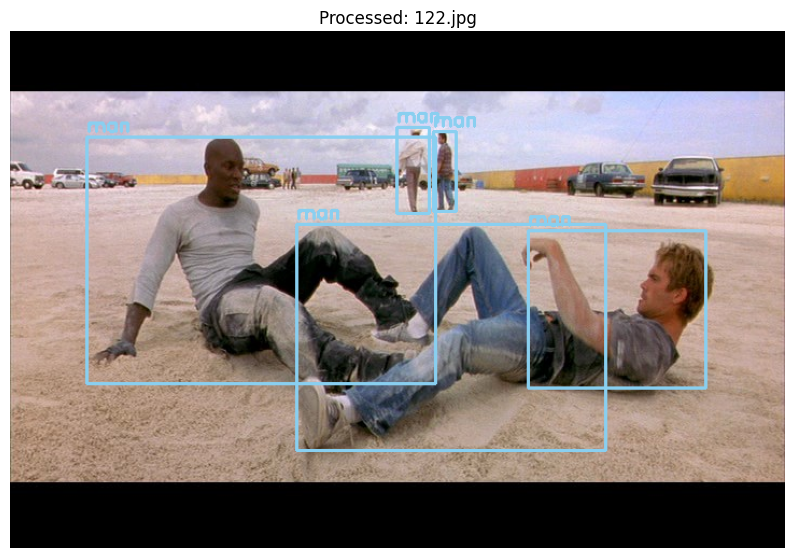

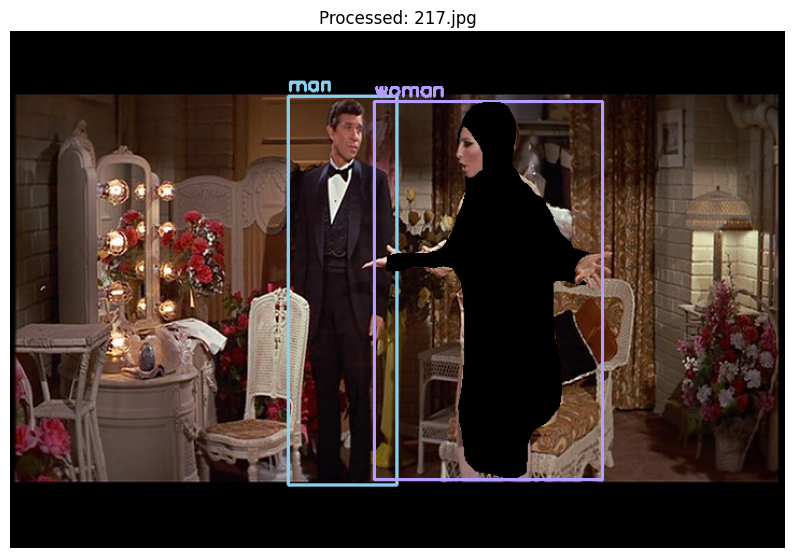

Processed 20 random images.


In [ ]:
random_images = random.sample(image_paths, 20)

# Define class labels and colors
class_labels = {1: "man", 2: "woman"}
colors = {1: (137, 207, 240), 2: (179, 158, 255)}

CONFIDENCE_THRESHOLD = 0.7  # Minimum confidence score
MASK_THRESHOLD = 0.7  # Mask binarization threshold

# Process only 20 random images
for image_path in random_images:
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    height, width = image_rgb.shape[:2]

    # Run inference
    outputs = predictor(image)

    instances = outputs["instances"].to("cpu")
    scores = instances.scores.numpy()  # Confidence scores

    valid_indices = scores > CONFIDENCE_THRESHOLD
    pred_boxes = instances.pred_boxes.tensor.numpy()[valid_indices]  # Bounding boxes
    pred_classes = (instances.pred_classes.numpy() + 1)[valid_indices]  # Class IDs
    pred_masks = instances.pred_masks.numpy()[valid_indices]  # Masks

    pred_masks = (pred_masks > MASK_THRESHOLD).astype(np.uint8)

    mask_category_2 = np.zeros((height, width), dtype=np.uint8)  # Mask for woman
    mask_category_3_4 = np.zeros((height, width), dtype=np.uint8)  # Mask for face & hand

    for i in range(len(pred_classes)):
        category_id = pred_classes[i]
        mask = pred_masks[i]

        if category_id == 2:
            mask_category_2 = np.maximum(mask_category_2, mask)

        elif category_id in [3, 4]:  # Face & hand
            mask_category_3_4 = np.maximum(mask_category_3_4, mask)

        if category_id in [1, 2]:
            x, y, x2, y2 = map(int, pred_boxes[i])
            color = colors[category_id]
            cv2.rectangle(image_rgb, (x, y), (x2, y2), color, 2)
            cv2.putText(image_rgb, class_labels[category_id],
                        (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

    mask_category_2[mask_category_3_4 > 0] = 0

    image_rgb[mask_category_2 > 0] = [0, 0, 0]

    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis("off")
    plt.title(f"Processed: {os.path.basename(image_path)}")
    plt.show()